# Analysis 3 - Connectivity of Stops with Bike Lanes

In [2]:
import pyproj

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import glob
import re

In [5]:
agency = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\agency.txt')
calendar = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\calendar.txt')
calendar_dates = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\calendar_dates.txt')
fare_attributes = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\fare_attributes.txt')
frequencies = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\frequencies.txt')
routes = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\routes.txt')
shapes = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\shapes.txt')
stop_times = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\stop_times.txt')
stops = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\stops.txt')
timepoint_times = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\timepoint_times.txt')
timepoints = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\timepoints.txt')
trips = pd.read_csv(r'C:\Users\hameed\Desktop\Datasets\GTFS Analysis\ffx_GTFS\connector_gtfs\trips.txt')

For this next analysis, we will import GIS data on bike lanes and perform a nearest neighbor analysis to determine the closest bike lane to each bus stop and the distance to this bike lane, we will then classify with a chloropleth map distances to bus stops from bike lanes based on bins for a range of distances.

The first step is to import and plot the bus stop and bike lane data to get a sense of it.

In [6]:
import geopandas as gpd
from sklearn.neighbors import BallTree
from shapely.geometry import Point, LineString, Polygon
import numpy as np

bike_lanes = gpd.read_file('..\Bicycle_Routes\Bicycle_Routes.shp')
stops_geo = gpd.GeoDataFrame(
    stops[['stop_id','stop_lat','stop_lon']], geometry=gpd.points_from_xy(stops.stop_lon, stops.stop_lat))

We will analyze the proximity of preferred, somewhat preferred and less preferred bike lanes to bus stops based on their status for a more granular level analysis. The assumption is that these routes have some kind of bike facility seperate from car travel lanes.

In [182]:
preferred = bike_lanes[(bike_lanes.STATUS=='PREFERRED')|(bike_lanes.STATUS=='SOMEWHAT')|(bike_lanes.STATUS=='LESS_PREFERRED')]

The first step in our analysis is to add a 200' buffer to all the lines in the bike lanes. Then, we will spatially_index the bus stops to optimize the operation. Using the bounding box co-ordinates of each bike lane, we will obtain a list of possible candidates from the spatial index of stops that fall within the bounding box for a particular bike lane. 

Then, using these possible candidates, we will perform the actual intersection query and it will be much quicker as it is optimized. We will add the final stops that fall within the buffered bike lane object to our final list. We will then get the unique values from this list as a set, and if a bus stop is in this list, we will add 'True' to a column in our stops_geo table that indicates this stop is wthin 10 feet of a bike lane.

In [183]:
preferred = preferred.to_crs('EPSG:2283')
preferred.head()

,OBJECTID,LABEL,ROUTE,ROAD_SPEED,SEGID,MAINTENANC,STATUS,BLOS,CreationDa,Creator,EditDate,Editor,Shape__Len,geometry
0,13126,WESTMORELAND ST,693,25.0,329579.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,186.102931,"LINESTRING (11861279.364 7013993.739, 11861176..."
1,13127,EAGLE LANDING RD,6580,25.0,336313.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,317.655144,"LINESTRING (11822833.292 6970753.734, 11822943..."
2,13128,CENTERVIEW DR,7680,25.0,5007223.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,279.093940,"LINESTRING (11786477.309 7010822.298, 11786514..."
3,13129,CHATELAIN RD,2948,25.0,331825.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,67.185749,"LINESTRING (11855953.311 6989583.724, 11855948..."
4,13130,BEVERLY RD,1898,25.0,328671.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,39.407509,"LINESTRING (11858880.393 7028119.253, 11858857..."


In [190]:
preferred['buffer_geom'] = preferred['geometry'].buffer(200)

In [191]:
preferred_buffers = gpd.GeoDataFrame(preferred[['OBJECTID','buffer_geom']], geometry='buffer_geom', crs="EPSG:2283").reset_index(drop=True)

We set the stops GeoDataFrame to the same CRS (EPSG:2283 - NOVA)

In [ ]:
stops_geo = stops_geo.set_crs('EPSG:4326')
stops_geo = stops_geo.to_crs('EPSG:2283')

In [193]:
preferred_buffers.head()

,OBJECTID,buffer_geom
0,13126,"POLYGON ((11861009.788 7014038.047, 11860999.7..."
1,13127,"POLYGON ((11822755.667 6971120.993, 11822763.3..."
2,13128,"POLYGON ((11786334.762 7010987.324, 11786418.0..."
3,13129,"POLYGON ((11855748.867 6989635.844, 11855748.3..."
4,13130,"POLYGON ((11858694.991 7028034.524, 11858684.3..."


In [194]:
def intersect_with_sindex(source_gdf, intersecting_gdf):
    source_sindex = source_gdf.sindex
    possible_matches_index = []
    
    for other in intersecting_gdf.itertuples():
        bounds = other.buffer_geom.bounds
        c = list(source_sindex.intersection(bounds))
        possible_matches_index += c
        
    unique_candidate_matches = list(set(possible_matches_index))
    possible_matches = source_gdf.iloc[unique_candidate_matches]
    
    result = possible_matches.loc[possible_matches.intersects(intersecting_gdf.unary_union)]
    return result

intersecting_stops = intersect_with_sindex(stops_geo, preferred_buffers)

It looks like we have a list of stops now that are within 200 ft of a bike lane, we can set the True, False Condtion for that.

In [195]:
stops_geo['within_200ft'] = stops_geo['stop_id'].isin(intersecting_stops['stop_id'])

In [196]:
display(stops_geo.head())
print(stops_geo['within_200ft'].value_counts())

,stop_id,stop_lat,stop_lon,geometry,within_50ft,within_200ft
0,3245,38.891683,-77.248563,POINT (11839098.917 7010211.882),True,True
1,3246,38.873912,-77.231425,POINT (11844065.836 7003807.218),True,True
2,3247,38.874153,-77.231529,POINT (11844035.018 7003894.573),True,True
3,3248,38.891647,-77.248377,POINT (11839152.032 7010199.494),True,True
4,3249,38.893318,-77.249593,POINT (11838797.668 7010803.303),True,True


True     2023
False    1028
Name: within_200ft, dtype: int64


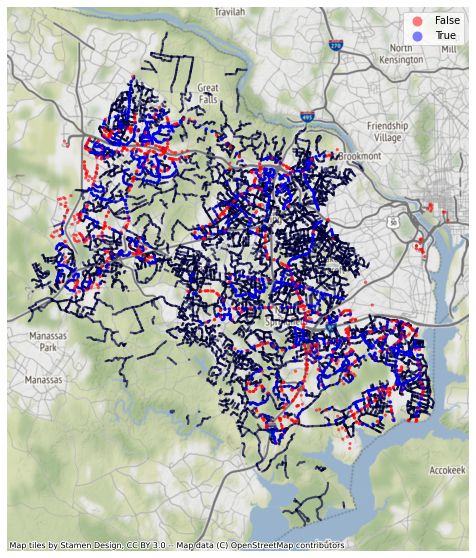

In [197]:
import contextily as cx
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list('mycmap', [(False, 'red'), (True, 'blue')])
fig, ax = plt.subplots(figsize=[10,10])
ax1 = preferred_buffers.plot(ax=ax, color='blue', edgecolor='black', alpha=0.5)
ax2 = stops_geo.plot(ax=ax1, column='within_200ft', markersize=5, alpha=0.5, legend=True, categorical=True, cmap=cmap)
cx.add_basemap(ax, crs=stops_geo.crs)
ax.set_axis_off()

In [198]:
import folium

m = preferred.explore(
     scheme="naturalbreaks", cmap='Accent', # use mapclassify's natural breaks scheme
     name="Preferred Bike Lanes" # name of the layer in the map
)

stops_geo.explore(
        m=m, # pass the map object
     column ='within_200ft', legend=True, categorical=True, cmap='Set1',
     name="Bus Stops" # name of the layer in the map
)

folium.TileLayer('Stamen Toner', control=True).add_to(m)  # use folium to add alternative tiles
folium.LayerControl().add_to(m)  # use folium to add layer control

m  # show map

This is an interesting result that we see, showing a significant portion of bus stops that are more than 200 feet away from a bike lane.

Let's calculate a density for each bike lane segment based on the number of stops it contains, divided by it's length so we can classify bike lanes with the most bus stops in a visual way.

In [211]:
display(len(preferred_buffers))

12480

In [212]:
densities = gpd.sjoin(preferred_buffers, stops_geo).groupby('OBJECTID').size().reset_index()
densities = densities.rename(columns={0: 'stop_cnt'})
display(densities.head())

,OBJECTID,stop_cnt
0,13126,2
1,13134,2
2,13135,2
3,13139,1
4,13140,2


In [215]:
preferred2 = preferred.merge(densities, on='OBJECTID', how='inner')
preferred2 = preferred2.drop(columns=['stop_cnt_x'])

In [216]:
preferred2['stop_density_200ft'] = preferred2['stop_cnt_y'] / preferred2['Shape__Len']

In [218]:
display(len(preferred2))
print(preferred2['stop_cnt_y'].sum()) #The additional value may be stops that are within 50 ft of two bike lane segments
preferred2.head()

2655

4875


,OBJECTID,LABEL,ROUTE,ROAD_SPEED,SEGID,MAINTENANC,STATUS,BLOS,CreationDa,Creator,EditDate,Editor,Shape__Len,geometry,buffer_geom,stop_density_200ft,stop_cnt_y
0,13126,WESTMORELAND ST,693,25.0,329579.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,186.102931,"LINESTRING (11861279.364 7013993.739, 11861176...","POLYGON ((11861009.788 7014038.047, 11860999.7...",0.010747,2
1,13134,BUENA VISTA AVE,1802,25.0,328371.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,41.005355,"LINESTRING (11857923.386 7024757.752, 11857912...","POLYGON ((11857719.717 7024743.600, 11857715.3...",0.048774,2
2,13135,PATHFINDER LN,1822,25.0,315075.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,34.986823,"LINESTRING (11856932.385 7024277.253, 11856914...","POLYGON ((11856742.886 7024204.354, 11856733.6...",0.057164,2
3,13139,OLD COLUMBIA PIKE,712,25.0,347379.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,47.011869,"LINESTRING (11860626.303 6986333.718, 11860655...","POLYGON ((11860497.895 6986494.097, 11860510.7...",0.021271,1
4,13140,PARK ST SE,675,25.0,349908.0,OTHER,LESS_PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,19.449084,"LINESTRING (11837626.355 7011928.770, 11837640...","POLYGON ((11837779.179 7012059.242, 11837792.6...",0.102833,2


In [219]:
display(preferred2.head())

,OBJECTID,LABEL,ROUTE,ROAD_SPEED,SEGID,MAINTENANC,STATUS,BLOS,CreationDa,Creator,EditDate,Editor,Shape__Len,geometry,buffer_geom,stop_density_200ft,stop_cnt_y
0,13126,WESTMORELAND ST,693,25.0,329579.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,186.102931,"LINESTRING (11861279.364 7013993.739, 11861176...","POLYGON ((11861009.788 7014038.047, 11860999.7...",0.010747,2
1,13134,BUENA VISTA AVE,1802,25.0,328371.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,41.005355,"LINESTRING (11857923.386 7024757.752, 11857912...","POLYGON ((11857719.717 7024743.600, 11857715.3...",0.048774,2
2,13135,PATHFINDER LN,1822,25.0,315075.0,VDOT,PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,34.986823,"LINESTRING (11856932.385 7024277.253, 11856914...","POLYGON ((11856742.886 7024204.354, 11856733.6...",0.057164,2
3,13139,OLD COLUMBIA PIKE,712,25.0,347379.0,VDOT,SOMEWHAT,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,47.011869,"LINESTRING (11860626.303 6986333.718, 11860655...","POLYGON ((11860497.895 6986494.097, 11860510.7...",0.021271,1
4,13140,PARK ST SE,675,25.0,349908.0,OTHER,LESS_PREFERRED,None,2022-02-12,FairfaxCounty,2022-02-12,FairfaxCounty,19.449084,"LINESTRING (11837626.355 7011928.770, 11837640...","POLYGON ((11837779.179 7012059.242, 11837792.6...",0.102833,2


In [221]:

z = stops_geo.explore(
     cmap='Pastel',
     name="Bus Stops" # name of the layer in the map
)

preferred2.explore(column='stop_cnt_y',
        m=z, # pass the map object
     scheme="naturalbreaks", cmap='Accent', legend=True, legend_kwds=dict(colorbar=False),k=10,
     name="Preferred Bike Lane Stop Counts"
)

folium.TileLayer('cartodbpositron', control=True).add_to(z)  # use folium to add alternative tiles
folium.LayerControl().add_to(z)  # use folium to add layer control

z  # show map